In [3]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import math
import seaborn as sn
import scipy.io as sio
import os

In [30]:
def SD_csi(csi_data):
    sd_vals=[]
    csi_data=np.array(csi_data)
    array_length=csi_data.shape[0] #or .size
    
    #use sd scope of 20
    # sd_sampling_range = 20
    # for i in range(0,array_length-sd_sampling_range):
    #     sd_value= np.std(csi_data[i:i+sd_sampling_range])
    #     features.append(sd_value)
    # return features
        
    #It seems to be some odd operation that is not sd
    #It is root mean square RMS ok
    sampling_range=10
    mean_val=csi_data.mean()
    for i in range(0,array_length-sampling_range):
        vals=[]
        for j in range(i,i+sampling_range):
            val=math.pow(csi_data[j]-mean_val,2)
            vals.append(val)
        val_append=math.sqrt(sum(vals)/sampling_range)
        sd_vals.append(val_append)
    return sd_vals
def convert_csi_to_features(csi_data_x,csi_data_y):
    features=np.array([])
    rms_val1=SD_csi(csi_data_x)
    rms_val2=SD_csi(csi_data_y)
    features=np.append(features,rms_val1)
    features=np.append(features,rms_val2)
    return features
def convert_ML_output(outputs):
    pass

1. Preparing data for training

In [34]:
datasets_folder="../CSI_Data_27122023"
quartiles=["Q1","Q2","Q3","Q4"]
subquartiles=["01","02","03","04"]
noPeople_str="noPeople"
x_axis="Horizontal"
y_axis="Vertical"
X=[] # data input for model
Y=[] # answers
#will be converted to list later

1.1 no People

In [40]:
#csv to df
fileX_dir=f"{datasets_folder}/{x_axis}/{noPeople_str}.csv"
df_x=pd.read_csv(fileX_dir)

fileY_dir=f"{datasets_folder}/{y_axis}/{noPeople_str}.csv"
df_y=pd.read_csv(fileY_dir)

In [41]:
#df to numpy

# df_x["CSI_DATA"]
# df_y["CSI_DATA"][0]
for row_x,row_y in zip(df_x["CSI_DATA"],df_y["CSI_DATA"]):
    row_x=row_x.replace("[","").replace("]","").strip()
    row_x=row_x.split(" ")
    row_x=[float(i) for i in row_x]
    row_y=row_y.replace("[","").replace("]","").strip()
    row_y=row_y.split(" ")
    row_y=[float(i) for i in row_y]

    X_i=convert_csi_to_features(row_x,row_y)
    # print(X_i)
    X.append(X_i)
    Y.append(0) #No people output =0
print(X)
print(Y)

[array([13.14133656, 10.40707579,  7.35576145, 11.00487286, 11.94836711,
       14.96436522, 15.67126276, 17.91545357, 18.34140743, 20.43467584,
       20.62040195, 22.24819603, 22.4725049 , 22.35664837, 21.94483941,
       20.99585618, 20.51282469, 19.75382182, 19.291377  , 18.32487317,
       18.04337764, 17.21049031, 16.91655185, 16.48600851, 16.30225373,
       16.0491737 , 15.88555874, 15.36150958, 15.36150958, 14.69718431,
       14.69718431, 13.92281317, 13.76298393, 12.76179754, 12.76179754,
       12.07868894, 12.04526781, 11.36308614, 11.36308614, 10.57152906,
       10.57152906,  9.8384311 ,  9.93011715,  9.3718849 ,  9.3718849 ,
        8.70996421,  8.88156667,  8.34908537,  8.42101399,  8.16859698,
        8.32697283,  8.32697283,  8.681214  ,  8.4365856 ,  8.89984419,
        8.71283401,  8.79316363,  8.69056825,  8.86219367,  8.86219367,
        9.16281761,  9.16281761,  9.38987362,  9.29386769,  9.67443676,
        9.94395427, 10.43616197, 10.52175017, 10.91477103, 10.9

1.2 single people in area

In [ ]:
#csv to df
for quartile in quartiles:
    for subquartile in subquartiles:
        fileX_dir=f"{datasets_folder}/{x_axis}/{quartile}/{subquartile}.csv"
        df_x=pd.read_csv(fileX_dir)

        fileY_dir=f"{datasets_folder}/{y_axis}/{quartile}/{subquartile}.csv"
        df_y=pd.read_csv(fileY_dir)

        #df to numpy
        for row_x,row_y in zip(df_x["CSI_DATA"],df_y["CSI_DATA"]):
            row_x=row_x.replace("[","").replace("]","").strip()
            row_x=row_x.split(" ")
            row_x=[float(i) for i in row_x]
            row_y=row_y.replace("[","").replace("]","").strip()
            row_y=row_y.split(" ")
            row_y=[float(i) for i in row_y]

            X_i=convert_csi_to_features(row_x,row_y)
            # print(X_i)
            X.append(X_i)
            Y.append(1)

In [93]:
#File reading to dataframe for training
quartile="Q1"
section="01"
axis="Horizontal"
file_dir = f"../CSI_Data_27122023/{axis}/{quartile}_{section}.csv"
data=pd.read_csv(file_dir)
#get only csi data (which is 26th column aka. -1)
# df=data.iloc[:,25]
df=data.iloc[:,-1]
df

0       [34 32 2 0 0 0 0 0 0 0 0 0 21 -17 22 -15 23 -1...
1       [-125 48 8 0 0 0 0 0 0 0 0 0 18 -16 32 -14 28 ...
2       [30 -32 1 0 0 0 0 0 0 0 0 0 14 -11 14 -9 15 -9...
3       [113 17 23 0 10 -12 2 -4 10 -7 6 -8 4 -14 5 -8...
4       [107 -79 22 0 1 -24 3 -16 -2 -9 1 -9 -3 -6 0 -...
                              ...                        
3235    [110 96 6 0 0 0 0 0 0 0 0 0 2 -12 -1 -13 1 -12...
3236    [110 96 6 0 0 0 0 0 0 0 0 0 8 -10 8 -9 8 -9 10...
3237    [110 96 6 0 0 0 0 0 0 0 0 0 10 -4 10 -9 10 -6 ...
3238    [110 96 6 0 0 0 0 0 0 0 0 0 -4 -15 -3 -14 -6 -...
3239    [110 96 6 0 0 0 0 0 0 0 0 0 -5 -29 1 -26 -2 -2...
Name: CSI_DATA, Length: 3240, dtype: object

In [1]:
#reform df
csi_data=[]
#equivalent to 2000 samples which is 2 seconds (crop 2 seconds out from start and end)
crop_row_start=1000;
crop_row_end=len(df)-1000;
for i in range(crop_row_start,crop_row_end):
    s=df[i].replace("[","").replace("]","").strip()
    ss=s.split(" ")
    csi_values=[float(val) for val in ss]
    csi_data.append(csi_values)
csi_data=np.array(csi_data)
csi_data_df=pd.DataFrame(csi_data)
csi_data


NameError: name 'df' is not defined

In [95]:
#convert to features
features=[]
for i in range(0,csi_data.shape[0]):
    features.append(csi_to_features(csi_data[i]))
    # features.append(csi_data[i])
features
features_df=pd.DataFrame(features)
features_df

,0,1,2,3,4,5,6,7,8,9,...,108,109,110,111,112,113,114,115,116,117
0,48.579560,32.328469,5.659499,5.382140,5.863440,6.525569,6.807528,7.847686,7.793142,8.569127,...,9.675287,9.591431,9.204886,8.956593,8.744208,8.573137,7.537941,7.110858,6.422270,6.061038
1,49.014382,32.708757,6.427500,6.229236,6.846437,7.392475,7.791338,8.275261,8.348294,9.349479,...,10.333514,9.950201,9.734697,9.432670,8.994718,8.859332,8.111062,7.616713,6.908686,6.612626
2,45.229983,29.744507,2.426047,3.241058,7.707834,8.059627,11.318117,11.996670,14.048902,14.601094,...,16.315725,16.189833,14.749568,14.610188,12.649349,12.536687,10.184152,10.138483,7.630720,7.642587
3,47.671112,31.559773,4.045899,4.035458,5.041601,6.045834,6.913003,7.824276,8.077007,9.157421,...,10.257570,9.903231,9.318610,9.174894,8.404552,8.165988,7.115932,6.722206,5.398257,5.018770
4,47.101765,31.099105,3.066653,1.786577,4.476988,4.529899,6.113227,6.152082,7.223312,7.362467,...,8.649855,8.670243,8.080338,8.102159,7.163579,7.157032,6.074124,6.074124,4.476988,4.516253
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1235,45.624374,30.004776,1.933025,2.084696,3.951545,4.272992,5.242914,5.714348,6.471743,6.859234,...,9.081008,8.869049,8.071692,7.745101,6.817534,6.692978,5.593581,5.111020,3.551719,3.306342
1236,43.604941,28.891774,6.183415,6.199062,5.866238,5.512508,5.174480,4.749039,4.420859,3.940605,...,3.769565,4.149578,4.410597,4.802694,4.929845,5.321559,5.436588,5.706651,5.899173,6.199062
1237,47.694948,31.579443,4.087933,5.020141,7.544054,8.525711,9.877782,10.771792,12.154935,13.657196,...,16.967762,16.496362,15.122064,14.887766,13.186295,12.916932,10.912376,10.585306,8.017575,7.855448
1238,42.313573,28.666199,10.523829,10.579212,10.389044,9.875524,9.437014,9.332121,8.866777,8.313827,...,10.571233,10.832000,10.832000,10.718604,10.980425,10.626075,10.724142,10.981278,10.876338,11.304633


In [96]:
min(features_df), max(features_df)

(0, 117)

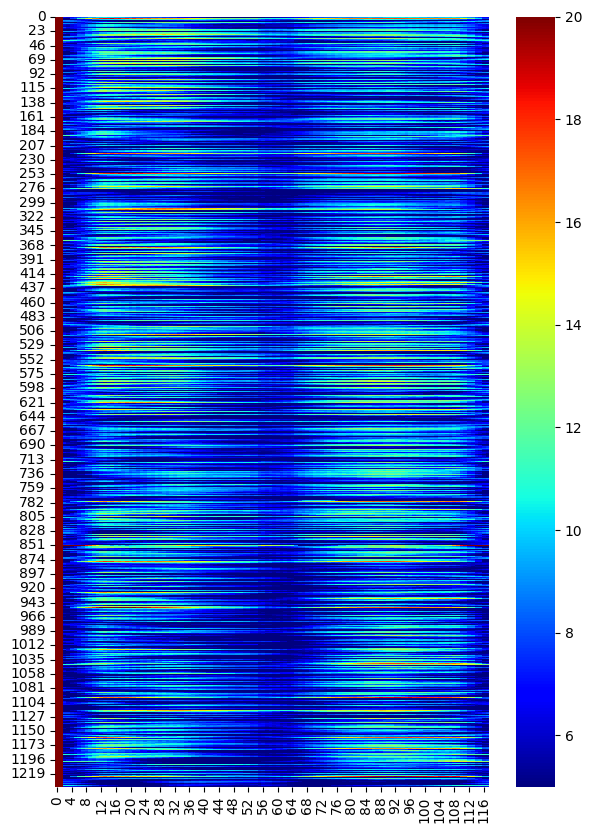

In [97]:
plt.figure(figsize=(7,10))
sn.heatmap(features_df,cmap="jet",vmin=5,vmax=20)
# sn.heatmap(features_df.T,cmap="jet")
plt.show()

In [1]:
#goal
def get_map_data_from_single_csi(csi_data_x,csi_data_y):
    pass
def get_map_data_from_csi(csi_datas):
    #if we are detecting only single person
        #sum all the csi datas
        #get the max
        #convert output to show max only
        #normalize it to 1
        #return
    sum_csi_data=np.sum(csi_datas,axis=0)
    max_csi_data=max(sum_csi_data)
    max_csi_data_index=np.where(sum_csi_data==max_csi_data)[0][0]
    output=np.zeros(sum_csi_data.shape)
    output[max_csi_data_index]=1
    return output
    

    #if we are detecting multiple people

    pass